In [ ]:
# ! apt-get install imagemagick

In [ ]:
import numpy as np
import seaborn as sns

from IPython.display import Image, clear_output
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation, ImageMagickFileWriter

sns.set(font_scale=1.6, palette='RdBu')

## Сравнение основных neural net оптимизаторов

#### 1. SGD

Обычный и стохастический градиентный спуск.

$$x_{t + 1} = x_t - \eta v_t,$$

где $v_{t} = \nabla f(x_{t})$ &mdash; аналогия со скоростью.

In [ ]:
def sgd(init_parameters, func_grad, lr, n_iter):
    parameters = init_parameters.copy()
    history = [parameters.copy()]

    for i in range(n_iter):
        diff = -lr * func_grad(parameters)
        parameters += diff
        history.append(parameters.copy())

    return history

#### 2. SGD + Momentum

Сгладим градиент, используя информацию о том, как градиент изменялся раньше.
Физическая аналогия &mdash; добавляем инерцию.


$$x_{t + 1} = x_t + v_{t},$$
где $v_{t} = \mu v_{t - 1} - \eta \nabla f(x_{t})$ &mdash; сглаживаем градиенты.

In [ ]:
def sgd_momentum(init_parameters, func_grad, lr, mu, n_iter):
    parameters = init_parameters.copy()
    history = [parameters.copy()]
    diff = np.zeros_like(parameters)

    for i in range(n_iter):
        diff = mu * diff - lr * func_grad(parameters)
        parameters += diff
        history.append(parameters.copy())

    return history

#### 3. Adagrad

Пусть $x^{(i)}$ &mdash; $i$-я компонента вектора $x$.
$$x_{t+1, i} = x_{t, i} - \frac{\eta}{\sqrt{g_{t, i}+\varepsilon}}\cdot \nabla f_i(x_t)$$
$$g_{t} = g_{t-1} + \nabla f(x_t) \odot \nabla f(x_t)$$


В матрично-векторном виде шаг алгоритма можно переписать так:
$$x_{t+1} = x_{t} - \frac{\eta}{\sqrt{g_{t} + \varepsilon}}\odot \nabla f(x_t).$$
Здесь $\odot$ обозначает произведение Адамара, т.е. поэлементное перемножение векторов.

In [ ]:
def adagrad(init_parameters, func_grad, lr, eps, n_iter):
    parameters = init_parameters.copy()
    history = [parameters.copy()]
    norm = np.zeros_like(parameters)

    for iter_id in range(n_iter):
        cur_grad = func_grad(parameters)
        norm += cur_grad ** 2
        parameters -= lr * cur_grad / np.sqrt(norm + eps)
        history.append(parameters.copy())

    return history

#### 4. RMSProp

Предлагается использовать **экспоненциальное сглаживание**.
$$x_{t+1} = x_{t} - \frac{\eta}{\sqrt{g_{t} + \varepsilon}}\odot \nabla f(x_t).$$
$$g_t = \mu g_{t-1} + (1-\mu) \nabla f(x_t) \odot \nabla f(x_t)$$

Стандартные значения гиперпараметров: $\mu = 0.9, \eta = 0.001$.

In [ ]:
def rmsprop(init_parameters, func_grad, lr, mu, eps, n_iter):

    parameters = init_parameters.copy()
    history = [parameters.copy()]
    norm = np.zeros_like(parameters)

    for iter_id in range(n_iter):
        cur_grad = func_grad(parameters)
        norm = mu * norm + (1 - mu) * cur_grad ** 2
        parameters -= lr * cur_grad / np.sqrt(norm + eps)
        history.append(parameters.copy())

    return history

**5. Adam**

Этот алгоритм совмещает в себе 2 идеи:
* идею алгоритма Momentum *о накапливании градиента*,
* идею методов Adagrad и RMSProp *об экспоненциальном сглаживании* информации о предыдущих значениях квадратов градиентов.

Благодаря использованию этих двух идей, метод имеет 2 преимущества над большей частью методов первого порядка, описанных выше:


1. Он обновляет все параметры $\theta$ не с одинаковым `learning rate`, а выбирает для каждого $\theta_i$ индивидуальный `learning rate`, что *позволяет учитывать разреженные признаки с большим весом*.


2. Adam за счёт применения экспоненциального сглаживания к градиенту *работает более устойчиво в окрестности оптимального значения параметра $\theta^*$*, чем методы, использующие градиент в точке $x_t$, не накапливая значения градиента с прошлых шагов.


Формулы шага алгоритма выглядят так:
$$v_{t + 1} = \beta v_{t} + (1-\beta) \nabla x(x_{t})$$
$$g_t = \mu g_{t-1} + (1-\mu) \nabla x(x_t) \odot \nabla x(x_t)$$

Чтобы эти оценки не были смещёнными, нужно их отнормировать:
$$\widehat{v}_{t + 1} = \frac{v_{t + 1}}{1-\beta^t},$$
$$\widehat{g}_t = \frac{g_t}{1-\mu^t}.$$

Тогда получим итоговую формулу шага:

$$x_{t+1} = x_t - \frac{\eta}{\sqrt{\widehat{g}_t + \varepsilon}} \odot \widehat{v}_{t + 1}.$$

In [ ]:
def adam(init_parameters, func_grad, eps, lr, beta, mu,  n_iter):

    parameters = init_parameters.copy()
    history = [parameters.copy()]
    cumulative_m = np.zeros_like(parameters)
    cumulative_v = np.zeros_like(parameters)
    pow_beta, pow_mu = beta, mu

    for iter_id in range(n_iter):
        current_grad = func_grad(parameters)
        cumulative_m = beta * cumulative_m + (1 - beta) * current_grad
        cumulative_v = mu * cumulative_v + (1 - mu) * current_grad ** 2

        scaled_m = cumulative_m / (1 - pow_beta)
        scaled_v = cumulative_v / (1 - pow_mu)
        parameters = parameters - lr * cumulative_m / (np.sqrt(cumulative_v) + eps)
        history.append(parameters)

        pow_beta *= beta
        pow_mu *= mu

    return history

#### Статьи.

Ссылки на оригинальные авторские статьи

* Adagrad: http://www.jmlr.org/papers/volume12/duchi11a/duchi11a.pdf,

* Adam: https://arxiv.org/abs/1412.6980.

Как можно заметить, для нейросетей мы рассматриваем *только методы оптимизации первого порядка*. Это связано с тем, что эффективные архитектуры нейронных сетей имеют большое количество параметров, из-за чего методы второго порядка, требующие на одну итерацию $O(d^2)$ памяти и выполняющие $O(d^3)$ операций, работают слишком долго и их преимущество в количестве итераций до сходимости утрачивает смысл.

Реализуем функции, которые будем оптимизировать.

In [ ]:
def square_sum(x):
    ''' f(x, y) = 5 x^2 + y^2 '''

    return 5 * x[0]**2 + x[1]**2

def square_sum_grad(x):
    ''' grad f(x, y) = (10x, 2y) '''

    return np.array([10, 2]) * x


def complex_sum(x):
    ''' f(x, y) = (x-3)^2 + 8(y-5)^4 + sqrt(x) + sin(xy)'''

    return (x[0]-3)**2 + 8 * (x[1]-5)**4 + x[0]**0.5 + np.sin(x[0]*x[1])

def complex_sum_grad(x):
    ''' grad f(x, y) = (2(x-3) + 1/(2 sqrt(x)) + ycos(xy), 32(y-5)^3 + xcos(xy)) '''

    partial_x = 2*(x[0]-3) + 0.5*x[0]**(-0.5) + x[1]*np.cos(x[0]*x[1])
    partial_y = 32*(x[1]-5)**3 + x[0]*np.cos(x[0]*x[1])

    return np.array([partial_x, partial_y])

In [ ]:
def make_experiment(func, trajectory, graph_title,
                    min_y=-7, max_y=7, min_x=-7, max_x=7):
    '''
    Функция, которая для заданной функции рисует её линии уровня,
    а также траекторию сходимости метода оптимизации.

    Параметры.
    1) func - оптимизируемая функция,
    2) trajectory - траектория метода оптимизации,
    3) graph_name - заголовок графика.
    '''

    fig, ax = plt.subplots(figsize=(10, 8))
    xdata, ydata = [], []
    ln, = plt.plot([], [])

    mesh_x = np.linspace(min_x, max_x, 300)
    mesh_y = np.linspace(min_y, max_y, 300)
    X, Y = np.meshgrid(mesh_x, mesh_y)
    Z = np.zeros((len(mesh_x), len(mesh_y)))

    for coord_x in range(len(mesh_x)):
        for coord_y in range(len(mesh_y)):
            Z[coord_y, coord_x] = func(
                np.array((mesh_x[coord_x],
                          mesh_y[coord_y]))
            )

    def init():
        ax.contour(
            X, Y, np.log(Z),
            np.log([0.5, 10, 30, 80, 130, 200, 300, 500, 900]),
            cmap='winter'
        )
        ax.set_title(graph_title)
        return ln,

    def update(frame):
        xdata.append(trajectory[frame][0])
        ydata.append(trajectory[frame][1])
        ln.set_data(xdata, ydata)
        return ln,

    ani = FuncAnimation(
        fig, update, frames=range(len(trajectory)),
        init_func=init, repeat=True
    )
    writer = ImageMagickFileWriter(fps=10)
    ani.save(f'saved_gifs/{graph_title}.gif',
             writer=writer)
    plt.show()

## Простая функция

$f(x, y) = 5 x^2 + y^2$

In [ ]:
parameters = np.array((5, 5), dtype=float)
func_name = '$f(x, y) = 5x^2 + y^2$'
func_grad = square_sum_grad
func = square_sum
n_iter = 100

**SGD**

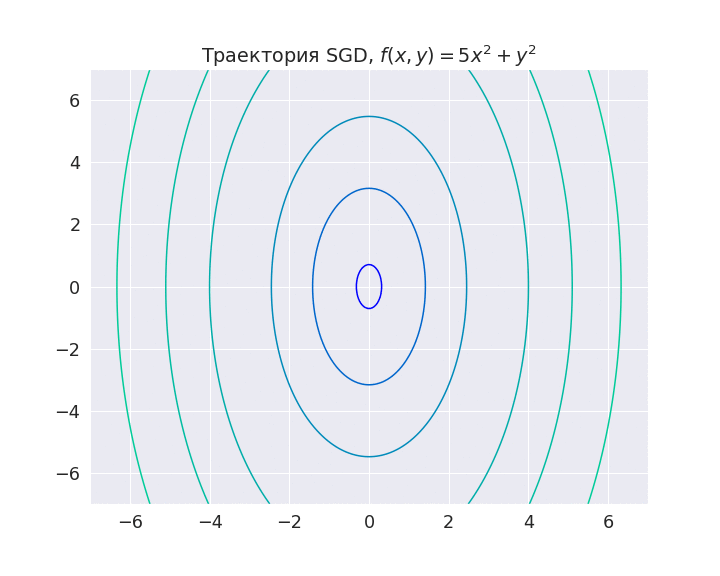

In [ ]:
sgd_trajectory = sgd(
    init_parameters=parameters,
    func_grad=func_grad,
    lr=0.01,
    n_iter=n_iter
)
graph_title = 'Траектория SGD, ' + func_name
make_experiment(
    func,
    sgd_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**SGD Momentum**

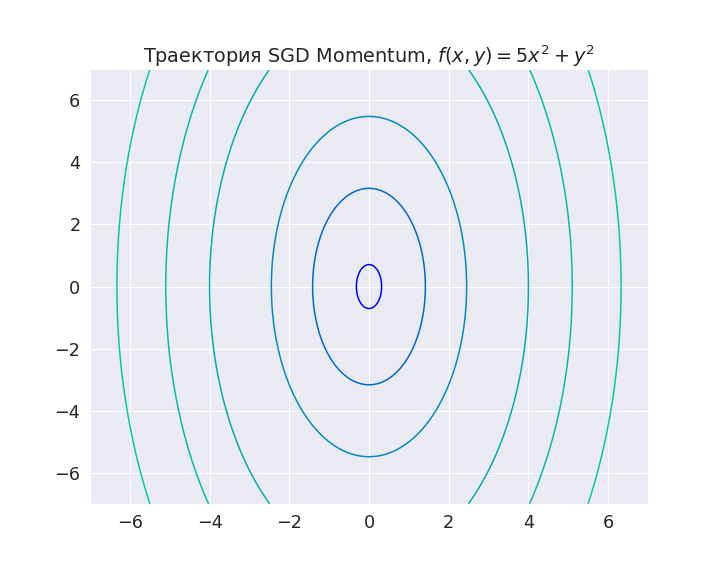

In [ ]:
sgd_momentum_trajectory = sgd_momentum(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.01,
    n_iter=n_iter,
    mu=0.9
)
graph_title = 'Траектория SGD Momentum, ' + func_name
make_experiment(
    func,
    sgd_momentum_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

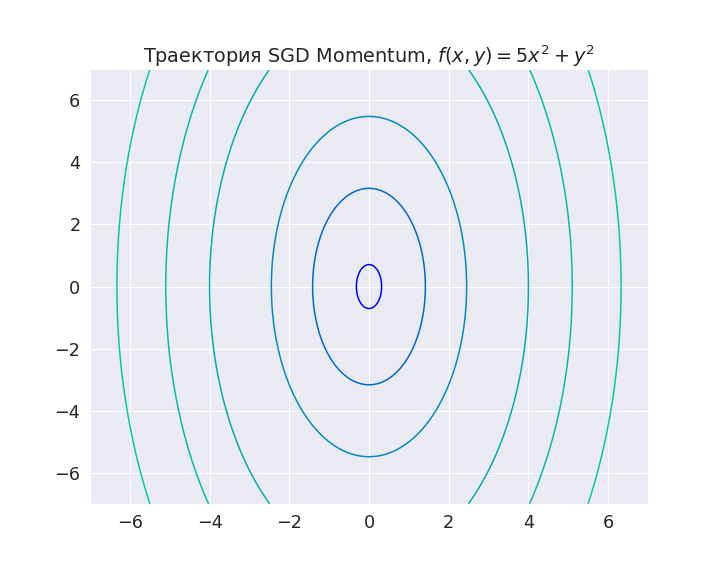

In [ ]:
sgd_momentum_trajectory = sgd_momentum(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.01,
    n_iter=n_iter,
    mu=0.7
)
graph_title = 'Траектория SGD Momentum, ' + func_name
make_experiment(
    func,
    sgd_momentum_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**Adagrad**

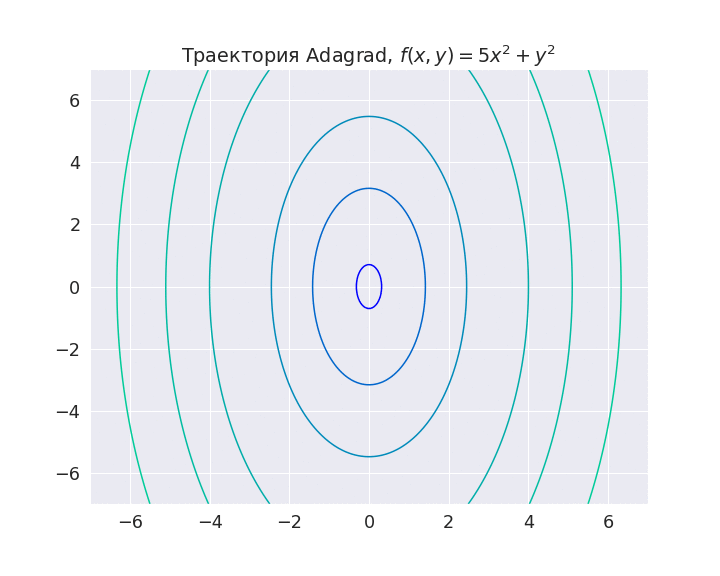

In [ ]:
adagrad_trajectory = adagrad(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
)
graph_title = 'Траектория Adagrad, ' + func_name
make_experiment(
    func,
    adagrad_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

По графику траектории можно заметить, что метод успел сделать очень небольшой шаг. Это связано с очень быстрой скоростью убывания адаптивного шага (learnnig rate). Поэтому для получения адекватных результатов с Adagrad стоит брать значение $\eta$ значительно больше чем при использовании SGD.

**RMSProp**

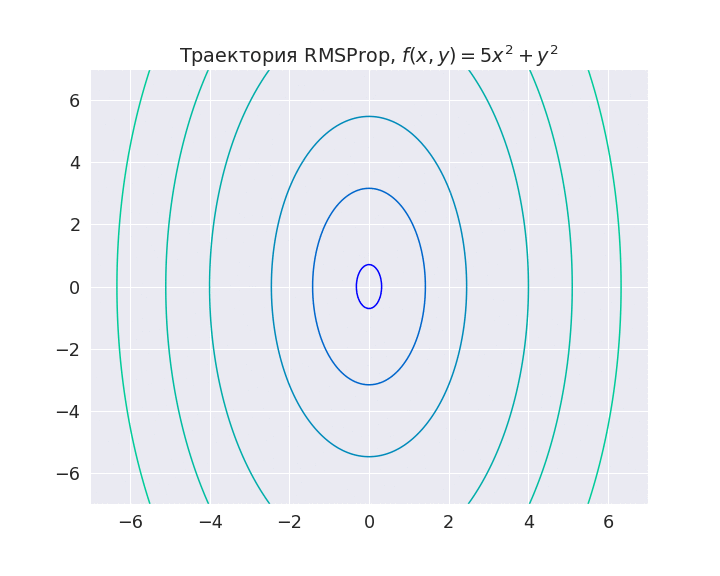

In [ ]:
rmsprop_trajectory = rmsprop(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
    mu=0.9
)
graph_title = 'Траектория RMSProp, ' + func_name
make_experiment(
    func,
    rmsprop_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**Adam**

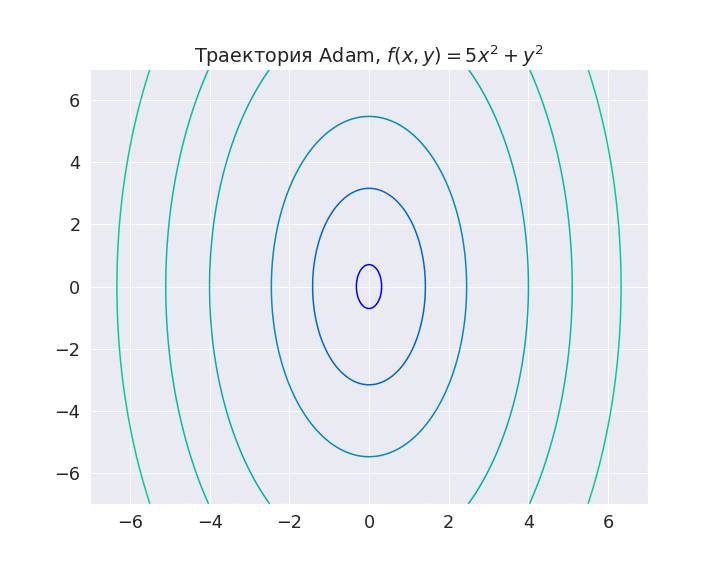

In [ ]:
adam_trajectory = adam(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
    mu=0.9,
    beta=0.9
)
graph_title = 'Траектория Adam, ' + func_name
make_experiment(
    func,
    adam_trajectory,
    graph_title,
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

## Сложная функция

$f(x, y) = (x-3)^2 + 8(y-5)^4 + \sqrt{x} + \sin(xy)$

In [ ]:
parameters = np.array((5, -2), dtype=float)
func_name = '$f(x, y) = (x-3)^2 + 8(y-5)^4 + \sqrt{x} + \sin(xy)$'
func_grad = complex_sum_grad
func = complex_sum
n_iter = 100

**SGD**

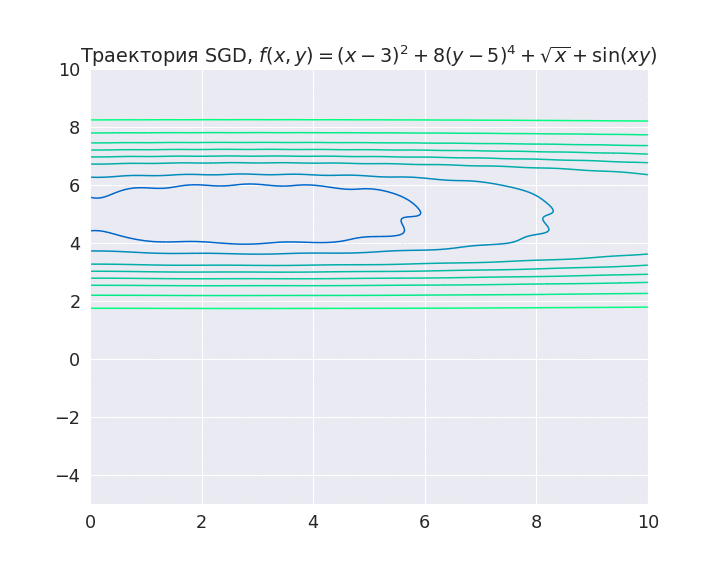

In [ ]:
sgd_trajectory = sgd(
    init_parameters=parameters,
    func_grad=func_grad,
    lr=0.0002,
    n_iter=n_iter
)
graph_title = 'Траектория SGD, ' +  func_name
make_experiment(
    func,
    sgd_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**SGD Momentum**

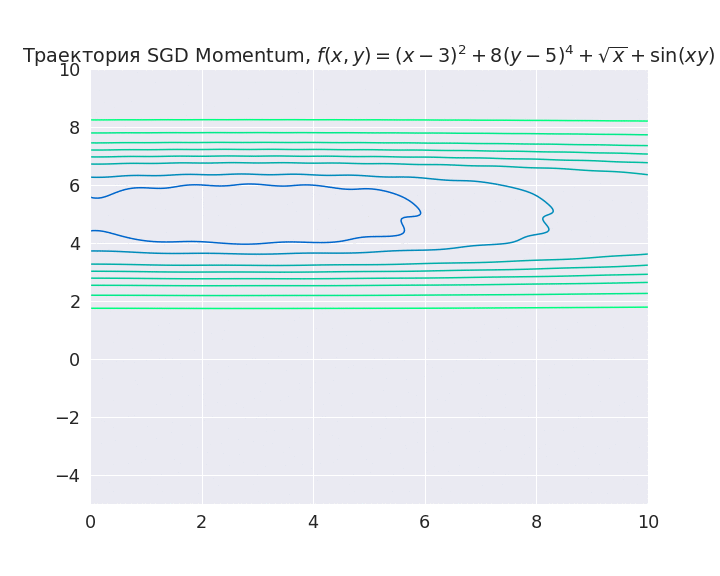

In [ ]:
sgd_momentum_trajectory = sgd_momentum(
    init_parameters=parameters,
    func_grad=func_grad,
    lr=0.0002,
    n_iter=n_iter,
    mu=0.9
)
graph_title = 'Траектория SGD Momentum, ' +  func_name
make_experiment(
    func,
    sgd_momentum_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

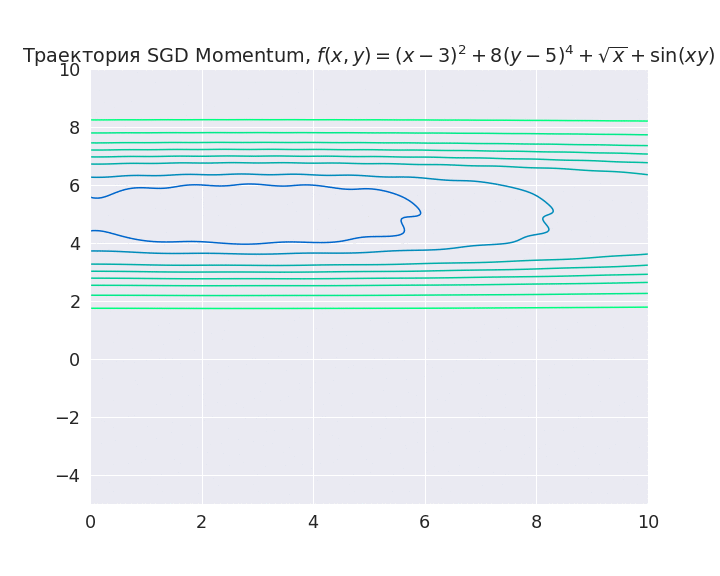

In [ ]:
sgd_momentum_trajectory = sgd_momentum(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.0002,
    n_iter=n_iter,
    mu=0.7
)
graph_title = 'Траектория SGD Momentum, ' +  func_name
make_experiment(
    func,
    sgd_momentum_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**Adagrad**

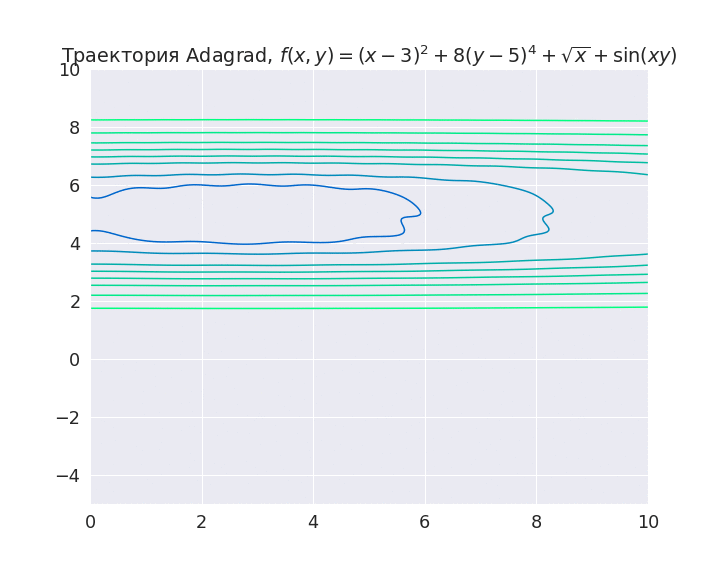

In [ ]:
adagrad_trajectory = adagrad(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
)
graph_title = 'Траектория Adagrad, ' + func_name
make_experiment(
    func,
    adagrad_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**RMSProp**

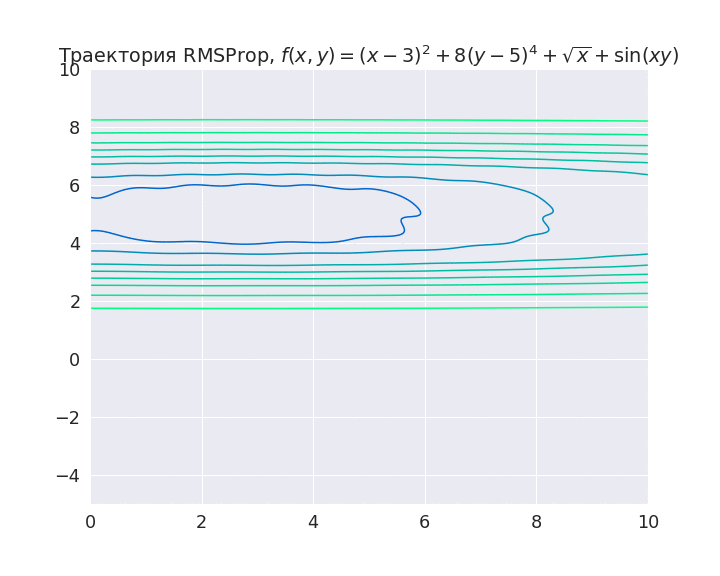

In [ ]:
rmsprop_trajectory = rmsprop(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
    mu=0.9
)
graph_title = 'Траектория RMSProp, ' + func_name
make_experiment(
    func,
    rmsprop_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())

**Adam**

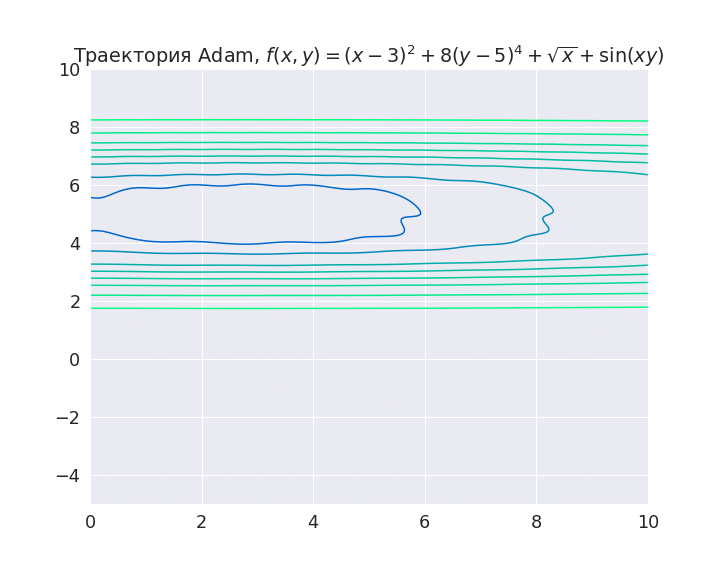

In [ ]:
adam_trajectory = adam(
    init_parameters=parameters.copy(),
    func_grad=func_grad,
    lr=0.1,
    n_iter=n_iter,
    eps=1e-6,
    mu=0.9,
    beta=0.9
)
graph_title = 'Траектория Adam, ' + func_name
make_experiment(
    func,
    adam_trajectory,
    graph_title,
    -5, 10, 0, 10
)
clear_output()
Image(open(f'saved_gifs/{graph_title}.gif','rb').read())